In [1]:
import pandas as pd
import plotly.offline as py
import plotly.express as px
from sklearn.cluster import KMeans
import warnings
py.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

In [2]:
data=pd.read_csv("covid19_italy_region.csv")
data.head()

,SNo,Date,Country,RegionCode,RegionName,Latitude,Longitude,HospitalizedPatients,IntensiveCarePatients,TotalHospitalizedPatients,HomeConfinement,CurrentPositiveCases,NewPositiveCases,Recovered,Deaths,TotalPositiveCases,TestsPerformed
0,1,2020-04-19T17:00:00,ITA,13,Abruzzo,42.351222,13.398438,317,40,357,1630,1987,34,276,258,2521,22424
1,2,2020-04-19T17:00:00,ITA,17,Basilicata,40.639471,15.805148,59,8,67,180,247,3,71,24,342,6528
2,3,2020-04-19T17:00:00,ITA,18,Calabria,38.905976,16.594402,142,6,148,696,844,24,116,75,1035,22234
3,4,2020-04-19T17:00:00,ITA,15,Campania,40.839566,14.250850,590,61,651,2371,3022,41,703,304,4029,34994
4,5,2020-04-19T17:00:00,ITA,8,Emilia-Romagna,44.494367,11.341721,3166,289,3455,10097,13552,376,5985,3023,22560,88776


In [3]:
grp = data.groupby(['Date', 'RegionName'])['TotalPositiveCases', 'Deaths', 'Recovered'].max()
grp = grp.reset_index()
grp['Date'] = pd.to_datetime(grp['Date'])
grp['Date'] = grp['Date'].dt.strftime('%m/%d/%Y')
grp['Active'] = grp['TotalPositiveCases'] - grp['Recovered'] - grp['Deaths']
grp['Region'] =  grp['RegionName']


In [4]:
grp.columns

Index(['Date', 'RegionName', 'TotalPositiveCases', 'Deaths', 'Recovered',
       'Active', 'Region'],
      dtype='object')

In [5]:
grp["RegionName"].value_counts()

Abruzzo                  232
Liguria                  232
Umbria                   232
Emilia-Romagna           232
Calabria                 232
Lazio                    232
Friuli Venezia Giulia    232
Sardegna                 232
Basilicata               232
Sicilia                  232
Toscana                  232
Puglia                   232
Molise                   232
P.A. Bolzano             232
Marche                   232
Valle d'Aosta            232
Piemonte                 232
Lombardia                232
P.A. Trento              232
Campania                 232
Veneto                   232
Name: RegionName, dtype: int64

In [6]:
import requests
repo_url = 'https://gist.githubusercontent.com/datajournalism-it/48e29e7c87dca7eb1d29/raw/2636aeef92ba0770a073424853f37690064eb0ea/regioni.geojson'
italy_regions_geo = requests.get(repo_url).json()


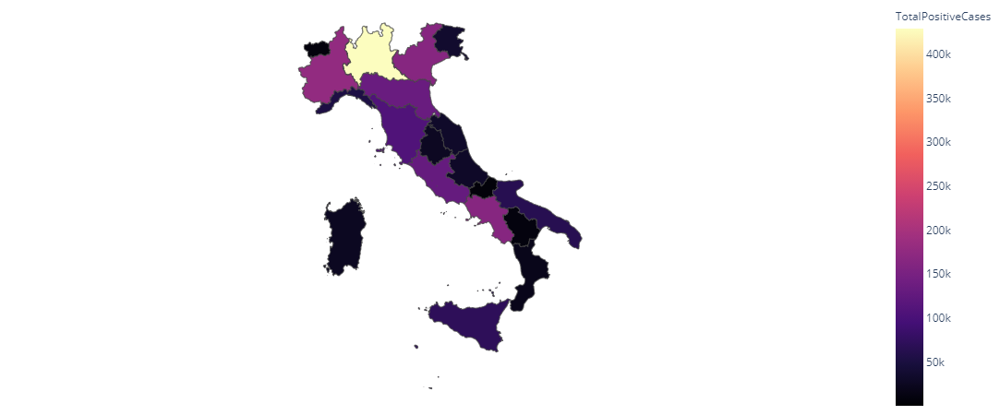

In [7]:
# Choropleth representing the length of region names
fig = px.choropleth(data_frame=grp, 
                    geojson=italy_regions_geo, 
                    locations='RegionName', # name of dataframe column
                    featureidkey='properties.NOME_REG',  # path to field in GeoJSON feature object with which to match the values passed in to locations
                    color='TotalPositiveCases',
                    color_continuous_scale="Magma",
                    scope="europe",
                   )
fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds="locations")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

<b> Symptoms of Coronavirus </b>

In [8]:
symptoms={'symptom':['Fever',
        'Dry cough',
        'Fatigue',
        'Sputum production',
        'Shortness of breath',
        'Muscle pain',
        'Sore throat',
        'Headache',
        'Chills',
        'Nausea or vomiting',
        'Nasal congestion',
        'Diarrhoea',
        'Haemoptysis',
        'Conjunctival congestion'],'percentage':[87.9,67.7,38.1,33.4,18.6,14.8,13.9,13.6,11.4,5.0,4.8,3.7,0.9,0.8]}

symptoms=pd.DataFrame(data=symptoms,index=range(14))
symptoms

,symptom,percentage
0,Fever,87.9
1,Dry cough,67.7
2,Fatigue,38.1
3,Sputum production,33.4
4,Shortness of breath,18.6
5,Muscle pain,14.8
6,Sore throat,13.9
7,Headache,13.6
8,Chills,11.4
9,Nausea or vomiting,5.0


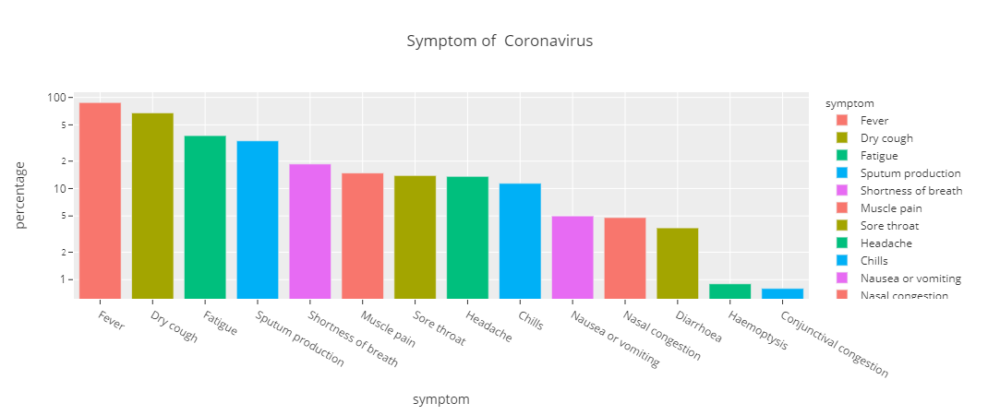

In [9]:
fig = px.bar(symptoms[['symptom', 'percentage']].sort_values('percentage', ascending=False), 
             y="percentage", x="symptom", color='symptom', 
             log_y=True, template='ggplot2', title='Symptom of  Coronavirus')
fig.show()

<b> Pie Chart </b>

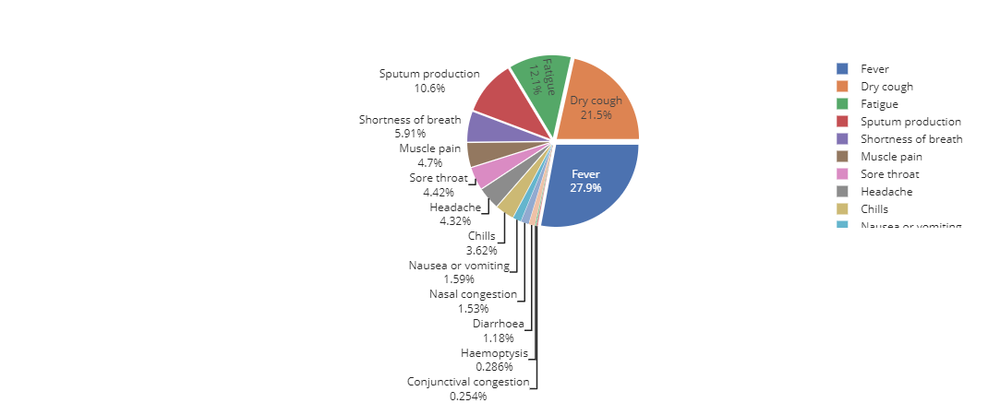

In [10]:
fig = px.pie(symptoms,
             values="percentage",
             names="symptom",
             template="seaborn")
fig.update_traces(rotation=90, pull=0.05, textinfo="percent+label")
fig.show()

<b> Tree Plot </b>

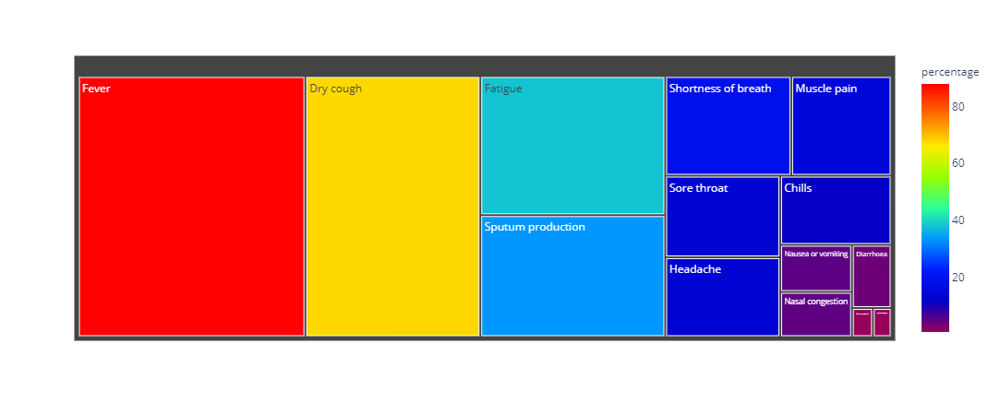

In [11]:
fig = px.treemap(symptoms, path=['symptom'], values='percentage',
                  color='percentage', hover_data=['symptom'],
                  color_continuous_scale='Rainbow')
fig.show()

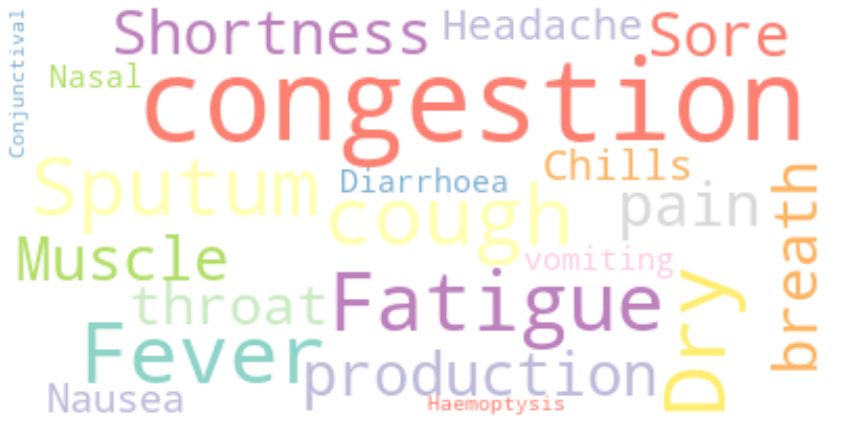

<Figure size 720x432 with 0 Axes>

In [12]:
from wordcloud import WordCloud, ImageColorGenerator
from matplotlib import pyplot as plt
text = " ".join(str(each) for each in symptoms.symptom)
wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="white").generate(text)
plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='Bilinear')
plt.axis("off")
plt.figure(1,figsize=(12, 12))
plt.show()

<b> Checking for Null Value</b>

In [13]:
data.isna().sum()

SNo                          0
Date                         0
Country                      0
RegionCode                   0
RegionName                   0
Latitude                     0
Longitude                    0
HospitalizedPatients         0
IntensiveCarePatients        0
TotalHospitalizedPatients    0
HomeConfinement              0
CurrentPositiveCases         0
NewPositiveCases             0
Recovered                    0
Deaths                       0
TotalPositiveCases           0
TestsPerformed               0
dtype: int64

<b> Description of Data </b>

In [14]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
SNo,4872.0,2436.500000,1406.569586,1.000000,1218.750000,2436.500000,3654.250000,4.872000e+03
RegionCode,4872.0,11.857143,6.274442,1.000000,7.000000,12.000000,17.000000,2.200000e+01
Latitude,4872.0,43.046293,2.489036,38.115697,41.125596,43.616760,45.434905,4.649933e+01
Longitude,4872.0,12.225955,2.659221,7.320149,11.121231,12.388247,13.768136,1.686737e+01
HospitalizedPatients,4872.0,444.891626,1049.539112,0.000000,15.000000,84.500000,353.000000,1.034200e+04
IntensiveCarePatients,4872.0,43.440887,102.619736,0.000000,1.000000,7.000000,35.000000,9.490000e+02
TotalHospitalizedPatients,4872.0,488.332512,1148.661232,0.000000,17.000000,93.000000,384.250000,1.126400e+04
HomeConfinement,4872.0,6737.530583,17466.263112,0.000000,172.000000,924.500000,4242.500000,1.550660e+05
CurrentPositiveCases,4872.0,7225.863095,18413.380103,1.000000,196.000000,1035.500000,4596.250000,1.644060e+05
NewPositiveCases,4872.0,318.789819,894.258735,-229.000000,3.000000,26.000000,171.000000,1.148900e+04


<b> Tracking the cases </b>

In [15]:
data.shape

(4872, 17)

In [16]:
clus=data.loc[:,['SNo','Latitude','Longitude']]
clus.head()

,SNo,Latitude,Longitude
0,1,42.351222,13.398438
1,2,40.639471,15.805148
2,3,38.905976,16.594402
3,4,40.839566,14.250850
4,5,44.494367,11.341721


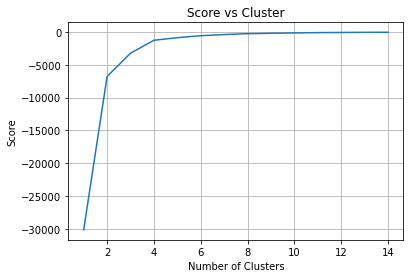

In [17]:
K_clusters = range(1,15)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = data[['Latitude']]
X_axis = data[['Longitude']]
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.grid()
plt.ylabel('Score')
plt.title('Score vs Cluster')
plt.show()

<b> The score get constant after 4 clusters , so making more clusters will not help. The value for k is 4 in this case</b>

In [18]:
kmeans = KMeans(n_clusters = 4, init ='k-means++')
kmeans.fit(clus[clus.columns[1:3]])
clus['cluster_label'] = kmeans.fit_predict(clus[clus.columns[1:3]])
centers = kmeans.cluster_centers_
labels = kmeans.predict(clus[clus.columns[1:3]])

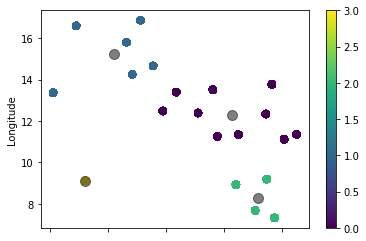

In [19]:
clus.plot.scatter(x = 'Latitude', y = 'Longitude', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=100, alpha=0.5)

In [20]:
import folium
italy_map = folium.Map(location=[42.8719,12.5674 ], zoom_start=5,tiles='Stamen Toner')

for lat, lon,RegionName,TotalPositiveCases,Recovered,Deaths,TotalHospitalizedPatients in zip(data['Latitude'], data['Longitude'],data['RegionName'],data['TotalPositiveCases'],data['Recovered'],data['Deaths'],data['TotalHospitalizedPatients']):
    folium.CircleMarker([lat, lon],
                        radius=5,
                        color='red',
                      popup =('RegionName: ' + str(RegionName) + '<br>'
                    'TotalPositiveCases: ' + str(TotalPositiveCases) + '<br>'
                    'TotalHospitalizedPatients: ' + str(TotalHospitalizedPatients) + '<br>'
                      'Recovered: ' + str(Recovered) + '<br>'
                      'Deaths: ' + str(Deaths) + '<br>'),

                        fill_color='red',
                        fill_opacity=0.7 ).add_to(italy_map)
italy_map

<p> The most affected cities and regions early in italy are Lombardy, and then Emilia-Romagna, Veneto, Marche, and Piemonte. Milan is the most populated city which is located in lombardy. Other areas in Italy which are affected by covid19 include Toscana, Campania, Lazio, Liguria, Friuli Venezia Giulia, Sicilia, Puglia, Umbria, Abruzzo, Trento, Molise, Calabria, Sardegna, Valle d’Aosta, Basilicata, and Bolzano. As italy was the fourth most affected coronavirus country till last feb but now it has reached the maximum number of confirmed cases after China and USA. </p>

<h1> Grouping data according to Region Name</h1>

In [21]:
data['Date'] = pd.to_datetime(data['Date']).dt.normalize()
daily = data.sort_values(['Date','Country','RegionName'])
latest = data[data.Date == daily.Date.max()]
latest.head()

,SNo,Date,Country,RegionCode,RegionName,Latitude,Longitude,HospitalizedPatients,IntensiveCarePatients,TotalHospitalizedPatients,HomeConfinement,CurrentPositiveCases,NewPositiveCases,Recovered,Deaths,TotalPositiveCases,TestsPerformed
4851,4852,2020-12-06,ITA,13,Abruzzo,42.351222,13.398438,667,71,738,16350,17088,294,12206,980,30274,246492
4852,4853,2020-12-06,ITA,17,Basilicata,40.639471,15.805148,119,18,137,6231,6368,81,2397,175,8940,160485
4853,4854,2020-12-06,ITA,18,Calabria,38.905976,16.594402,390,32,422,10239,10661,340,7533,343,18537,370059
4854,4855,2020-12-06,ITA,15,Campania,40.839566,14.250850,1916,155,2071,99172,101243,1552,62060,1990,165293,1153658
4855,4856,2020-12-06,ITA,8,Emilia-Romagna,44.494367,11.341721,2736,241,2977,65190,68167,1788,59432,6162,133761,1115823


In [22]:
data_groupby_region = latest.groupby("RegionName")[['TotalPositiveCases', 'Deaths', 'Recovered','TestsPerformed','HospitalizedPatients','TotalHospitalizedPatients']].sum().reset_index()
dgr = data_groupby_region 
dgr.head()

,RegionName,TotalPositiveCases,Deaths,Recovered,TestsPerformed,HospitalizedPatients,TotalHospitalizedPatients
0,Abruzzo,30274,980,12206,246492,667,738
1,Basilicata,8940,175,2397,160485,119,137
2,Calabria,18537,343,7533,370059,390,422
3,Campania,165293,1990,62060,1153658,1916,2071
4,Emilia-Romagna,133761,6162,59432,1115823,2736,2977


In [23]:
covid=dgr[['RegionName', 'TotalHospitalizedPatients',
       'Recovered', 'Deaths', 'TotalPositiveCases', 'TestsPerformed']]
covid.sort_values(by='TotalPositiveCases',ascending=False,inplace=True)
covid.style.background_gradient(cmap='BuGn')

,RegionName,TotalHospitalizedPatients,Recovered,Deaths,TotalPositiveCases,TestsPerformed
8,Lombardia,7179,289706,23024,429109,2415099
13,Piemonte,4598,105127,6623,177788,1000611
3,Campania,2071,62060,1990,165293,1153658
20,Veneto,2816,84235,4210,165249,1090932
4,Emilia-Romagna,2977,59432,6162,133761,1115823
6,Lazio,3476,33422,2622,130255,1882721
17,Toscana,1612,76331,2867,108397,983103
16,Sicilia,1580,29984,1759,71489,692062
14,Puglia,1816,16795,1712,64341,567857
7,Liguria,960,40842,2521,53779,298052


<b>Description of data by region</b>

In [24]:
dgr.describe().T

,count,mean,std,min,25%,50%,75%,max
TotalPositiveCases,21.0,82327.523810,98148.383247,5286.0,24186.0,35467.0,130255.0,429109.0
Deaths,21.0,2860.857143,4972.920071,135.0,531.0,1327.0,2622.0,23024.0
Recovered,21.0,43499.714286,63667.419390,2397.0,11008.0,18619.0,59432.0,289706.0
TestsPerformed,21.0,643340.666667,628595.765702,34644.0,231538.0,333552.0,1000611.0,2415099.0
HospitalizedPatients,21.0,1447.190476,1598.312035,56.0,410.0,667.0,1916.0,6372.0
TotalHospitalizedPatients,21.0,1611.666667,1778.475958,66.0,442.0,738.0,2071.0,7179.0


In [25]:
total=covid.sum().reset_index()
total.drop([0],inplace=True)
total.rename(columns={'index':'Detection',0 :'Total'},inplace=True)
total.style.background_gradient(cmap='BuGn')

,Detection,Total
1,TotalHospitalizedPatients,33845
2,Recovered,913494
3,Deaths,60078
4,TotalPositiveCases,1728878
5,TestsPerformed,13510154


<b> Region Name displaying by using wordcloud </b>

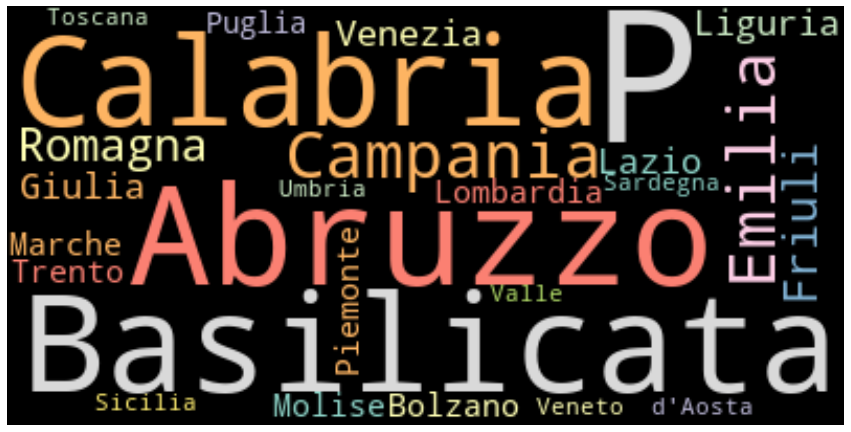

<Figure size 720x432 with 0 Axes>

In [26]:
from wordcloud import WordCloud, ImageColorGenerator
text = " ".join(str(each) for each in dgr.RegionName)
wordcloud = WordCloud(max_words=200,colormap='Set3', background_color="black").generate(text)
plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='Bilinear')
plt.axis("off")
plt.figure(1,figsize=(12, 12))
plt.show()

<b>Test performed vs Region </b>

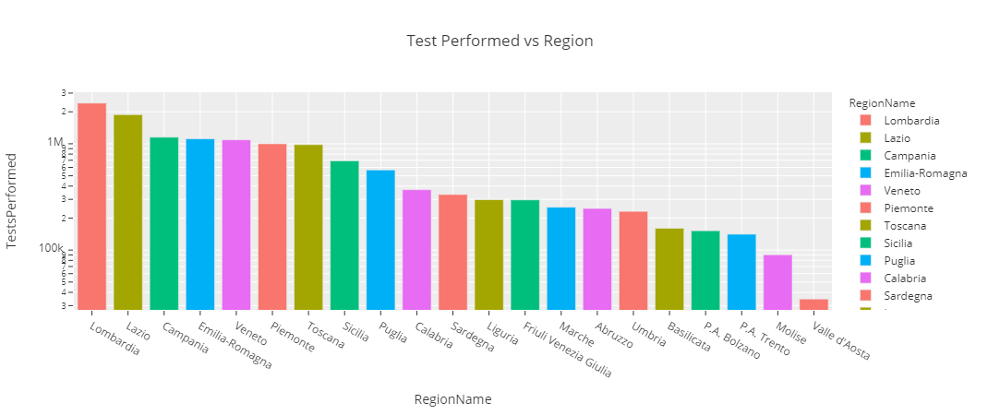

In [27]:
fig = px.bar(dgr[['RegionName', 'TestsPerformed']].sort_values('TestsPerformed', ascending=False), 
             y="TestsPerformed", x="RegionName", color='RegionName', 
             log_y=True, template='ggplot2', title='Test Performed vs Region')
fig.show()

<b> Tree Plot - Testperformed vs Region <b>

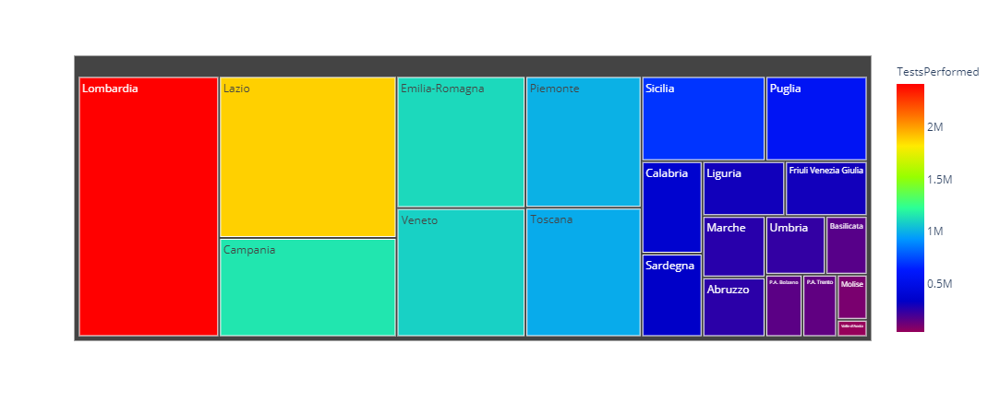

In [28]:
fig = px.treemap(dgr, path=['RegionName'], values='TestsPerformed',
                  color='TestsPerformed', hover_data=['RegionName'],
                  color_continuous_scale='Rainbow')
fig.show()

<p> The graph shows the different regions of italy according to tests performed.Lombardia has the highest number(2.4m) of tests performed. As a result it shows the highest number of positive cases. Lazio is the second most test performed cities followed by venento, campania, piemonte, toscana, emilia-romangna and sicilia and so on. </p>

<b> Confirmed Cases vs Region </b>

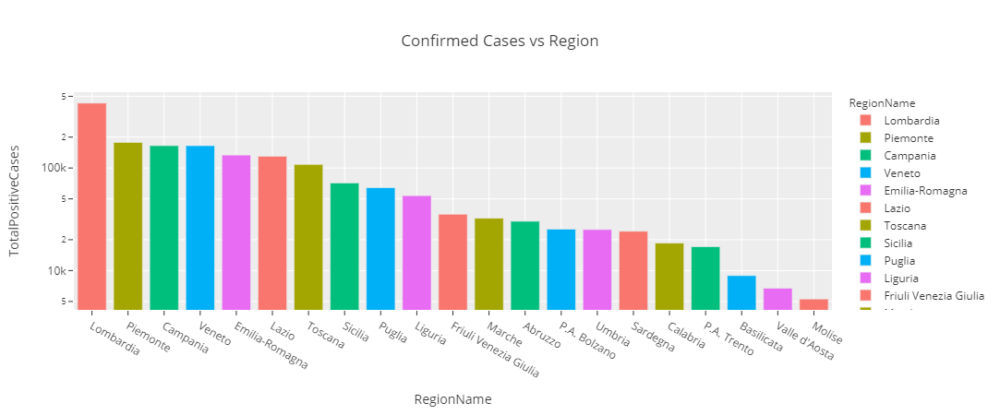

In [29]:
fig = px.bar(dgr[['RegionName', 'TotalPositiveCases']].sort_values('TotalPositiveCases', ascending=False), 
             y="TotalPositiveCases", x="RegionName", color='RegionName', 
             log_y=True, template='ggplot2', title='Confirmed Cases vs Region')
fig.show()

<b>Tree Plot - Confirmed Case vs Region </b>

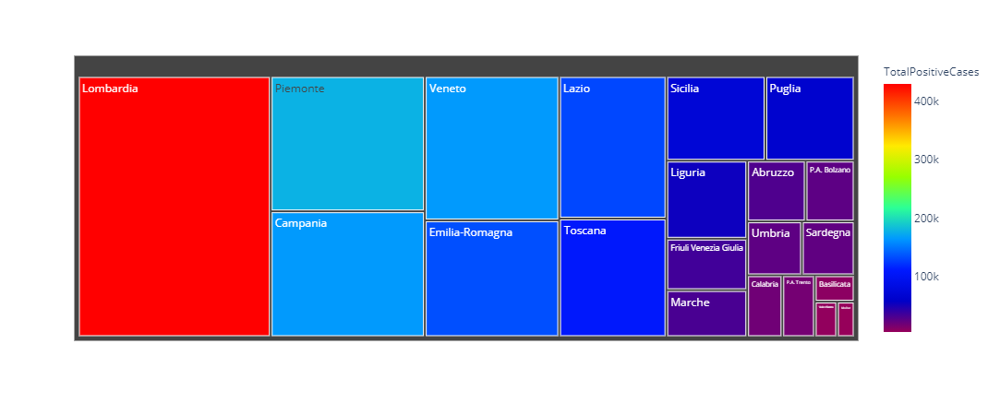

In [30]:
fig = px.treemap(dgr, path=['RegionName'], values='TotalPositiveCases',
                  color='TotalPositiveCases', hover_data=['RegionName'],
                  color_continuous_scale='Rainbow')
fig.show()

In [31]:
dgr["TotalPositiveCases"].sum()

1728878

<p> There are more than 17m people affected throughout this virus in Italy. Italy is the most affected country after china and USA. The Italy Government has restricted all the flights from china during that time . At that time , it was probably the best measure which can block the disease.</p>

<b> Hospitalized Patient vs Region </b>

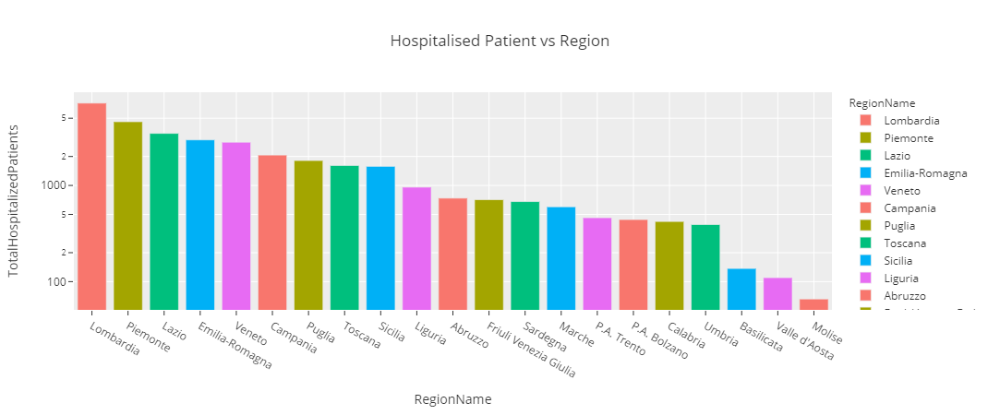

In [32]:
fig = px.bar(dgr[['RegionName', 'TotalHospitalizedPatients']].sort_values('TotalHospitalizedPatients', ascending=False), 
             y="TotalHospitalizedPatients", x="RegionName", color='RegionName', 
             log_y=True, template='ggplot2', title='Hospitalised Patient vs Region')
fig.show()

<b> Tree map - Hospitalized vs Region </b>

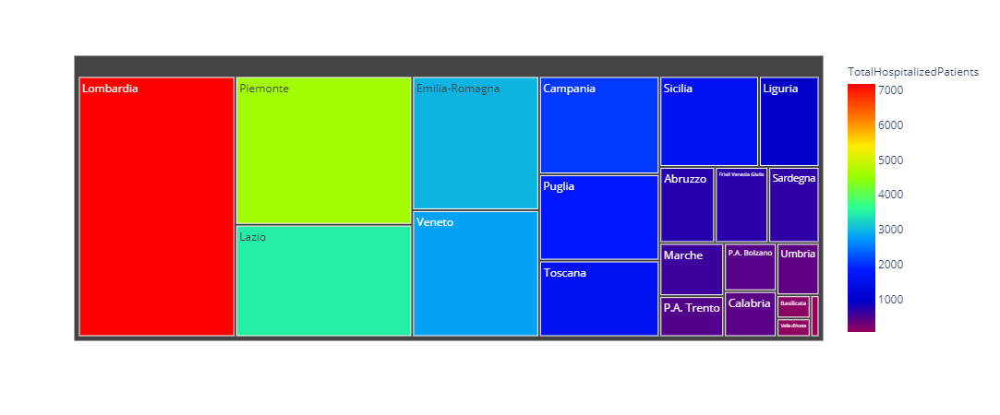

In [33]:
fig = px.treemap(dgr, path=['RegionName'], values='TotalHospitalizedPatients',
                  color='TotalHospitalizedPatients', hover_data=['RegionName'],
                  color_continuous_scale='Rainbow')
fig.show()

<b> Recovery vs Region </b>

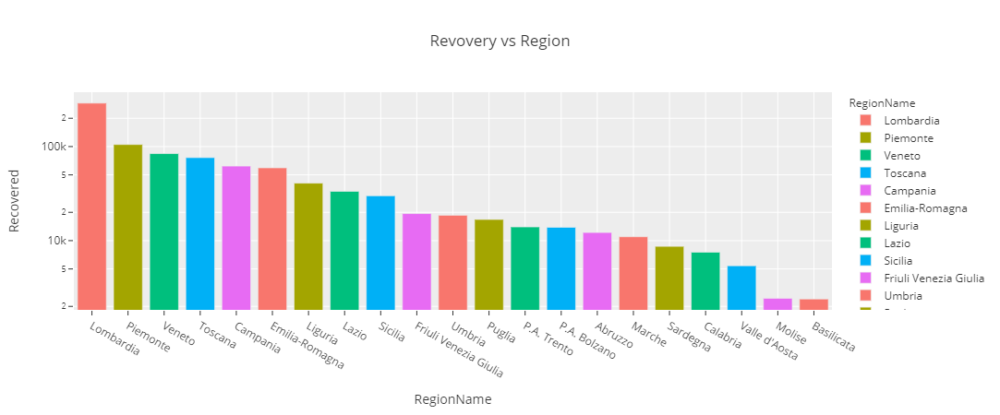

In [34]:
fig = px.bar(dgr[['RegionName', 'Recovered']].sort_values('Recovered', ascending=False), 
             y="Recovered", x="RegionName", color='RegionName', 
             log_y=True, template='ggplot2', title='Revovery vs Region')
fig.show()

<b>Tree Map -Recovery vs Region </b>

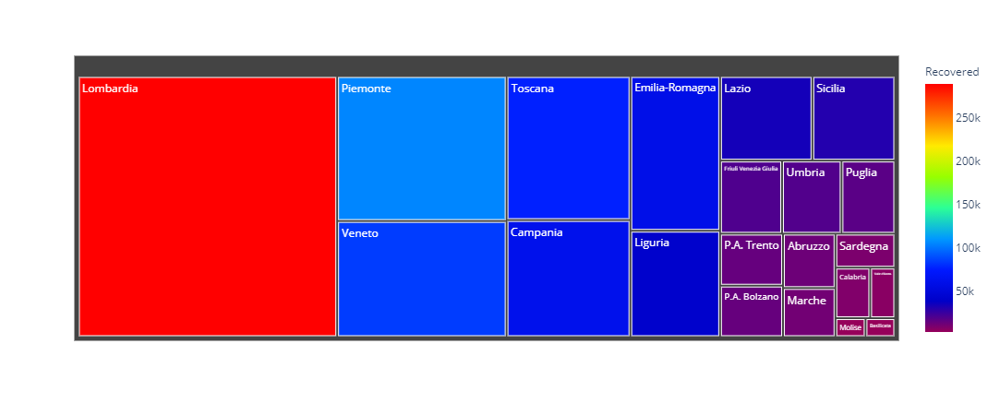

In [35]:
fig = px.treemap(dgr, path=['RegionName'], values='Recovered',
                  color='Recovered', hover_data=['RegionName'],
                  color_continuous_scale='Rainbow')
fig.show()

<b> Death vs Region Name </b>

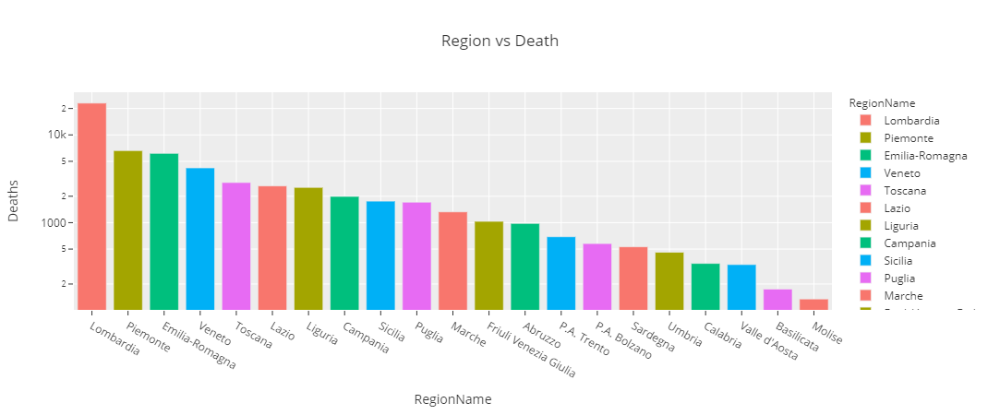

In [36]:
fig = px.bar(dgr[['RegionName', 'Deaths']].sort_values('Deaths', ascending=False), 
             y="Deaths", x="RegionName", color='RegionName', 
             log_y=True, template='ggplot2', title='Region vs Death')
fig.show()

<b> Tree map - Region vs Death </b>

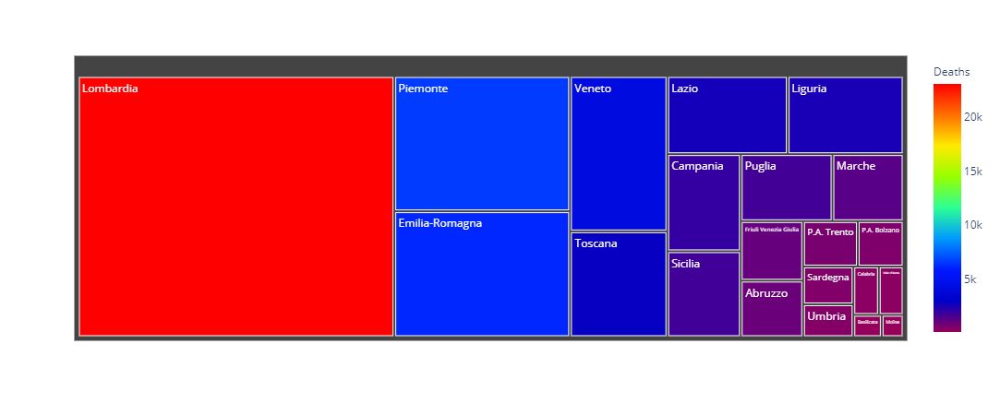

In [37]:
fig = px.treemap(dgr, path=['RegionName'], values='Deaths',
                  color='Deaths', hover_data=['RegionName'],
                  color_continuous_scale='Rainbow')
fig.show()

<b>Sort by confirmation </b>

In [38]:
dgrs_el = dgr.sort_values(by=['TotalPositiveCases'],ascending = False)
dgrs_el.head()

,RegionName,TotalPositiveCases,Deaths,Recovered,TestsPerformed,HospitalizedPatients,TotalHospitalizedPatients
8,Lombardia,429109,23024,289706,2415099,6372,7179
13,Piemonte,177788,6623,105127,1000611,4239,4598
3,Campania,165293,1990,62060,1153658,1916,2071
20,Veneto,165249,4210,84235,1090932,2508,2816
4,Emilia-Romagna,133761,6162,59432,1115823,2736,2977


<b> Test and Confirm vs Region </b>

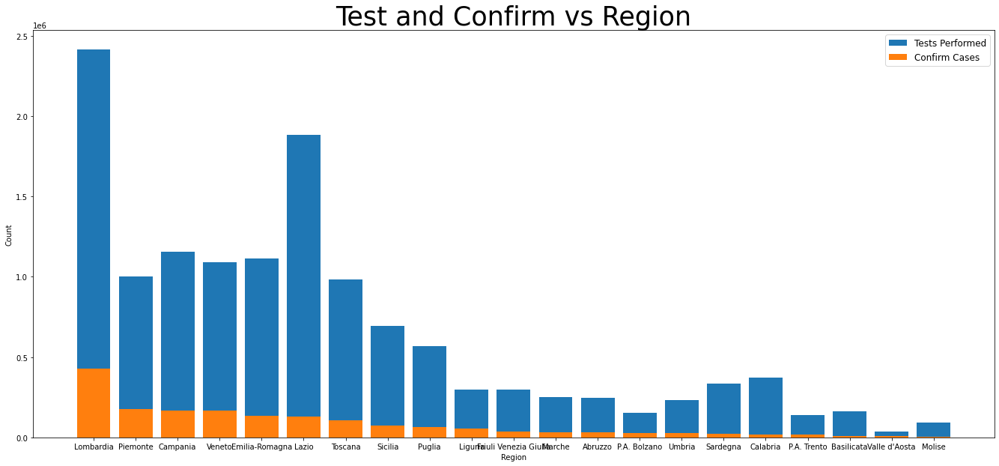

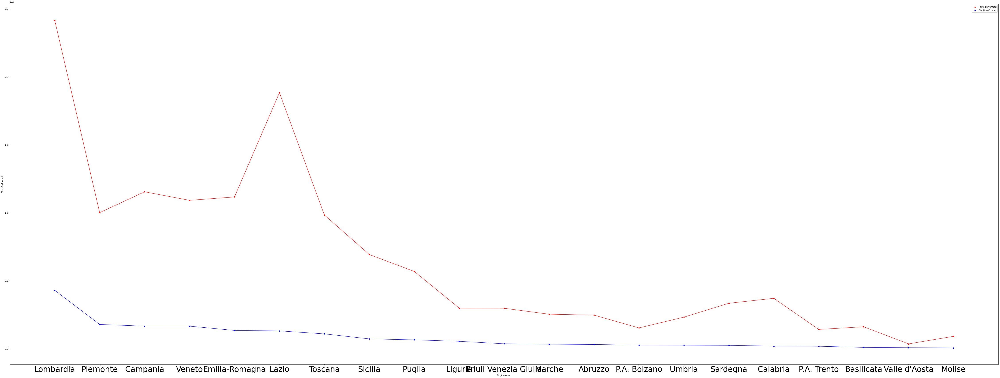

In [39]:
import seaborn as sns
plt.figure(figsize=(23,10))
plt.bar(dgrs_el.RegionName, dgrs_el.TestsPerformed,label="Tests Performed")
plt.bar(dgrs_el.RegionName, dgrs_el.TotalPositiveCases,label="Confirm Cases")
plt.xlabel('Region')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Test and Confirm vs Region',fontsize = 35)

plt.show()

f, ax = plt.subplots(figsize=(80,30))
ax=sns.scatterplot(x="RegionName", y="TestsPerformed", data=dgrs_el,
             color="red",label = "Tests Performed")
ax=sns.scatterplot(x="RegionName", y="TotalPositiveCases", data=dgrs_el,
             color="blue",label = "Confirm Cases")
ax.xaxis.set_tick_params(labelsize=35)

plt.plot(dgrs_el.RegionName,dgrs_el.TestsPerformed,zorder=1,color="red")
plt.plot(dgrs_el.RegionName,dgrs_el.TotalPositiveCases,zorder=1,color="blue")

<b> Confirmed cases vs People Hospitalized </b>

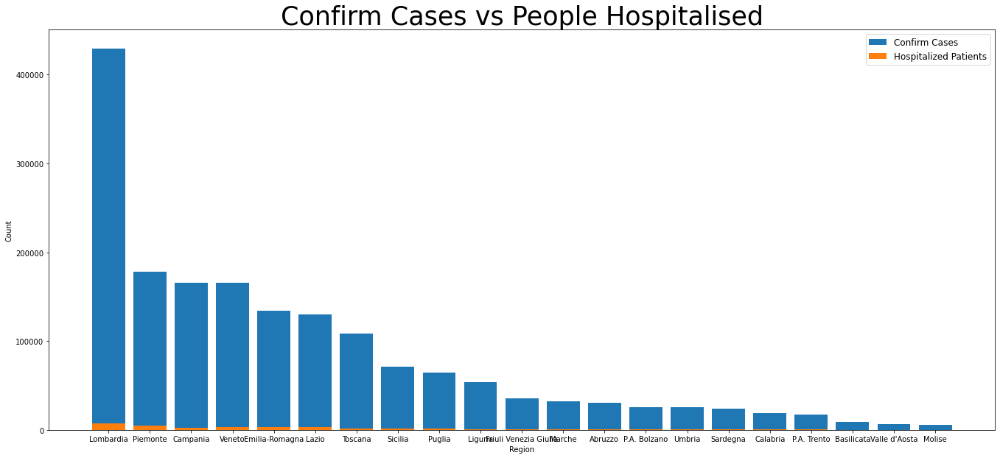

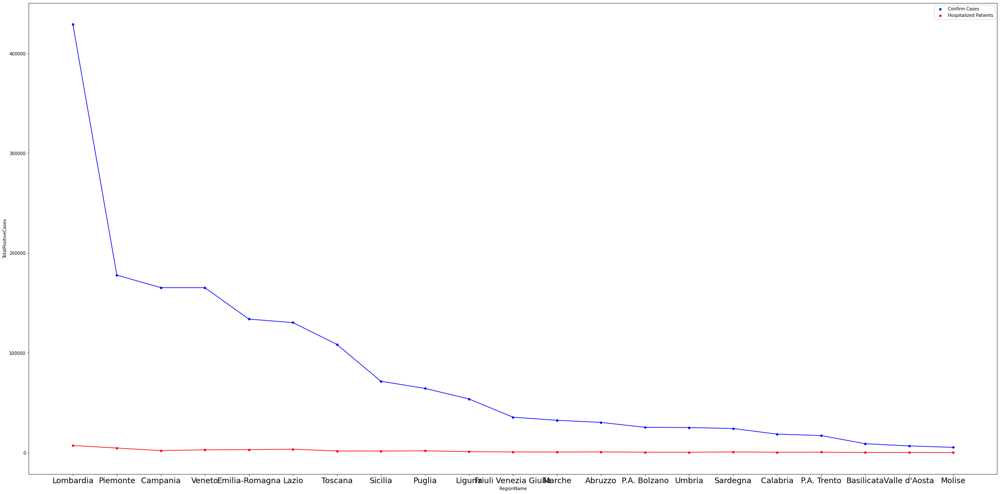

In [40]:
plt.figure(figsize=(23,10))
plt.bar(dgrs_el.RegionName, dgrs_el.TotalPositiveCases,label="Confirm Cases")
plt.bar(dgrs_el.RegionName, dgrs_el.TotalHospitalizedPatients,label="Hospitalized Patients")

plt.xlabel('Region')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confirm Cases vs People Hospitalised',fontsize= 35)
plt.show()

f, ax = plt.subplots(figsize=(40,20))

ax=sns.scatterplot(x="RegionName", y="TotalPositiveCases", data=dgrs_el,
             color="blue",label = "Confirm Cases")
ax=sns.scatterplot(x="RegionName", y="TotalHospitalizedPatients", data=dgrs_el,
             color="red",label = "Hospitalized Patients")
ax.xaxis.set_tick_params(labelsize=18)
plt.plot(dgrs_el.RegionName,dgrs_el.TotalPositiveCases,zorder=1,color="blue")
plt.plot(dgrs_el.RegionName,dgrs_el.TotalHospitalizedPatients,zorder=1,color="red")

<b> Death and Recovery vs Region </b>

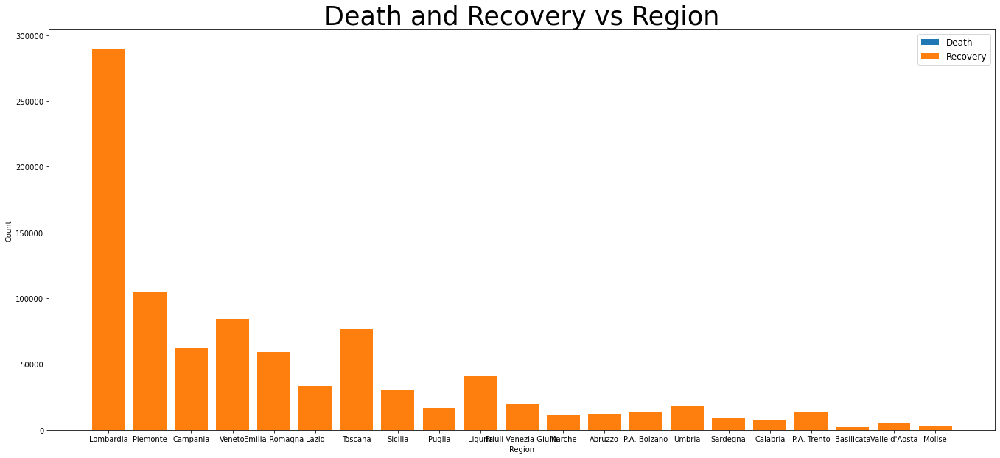

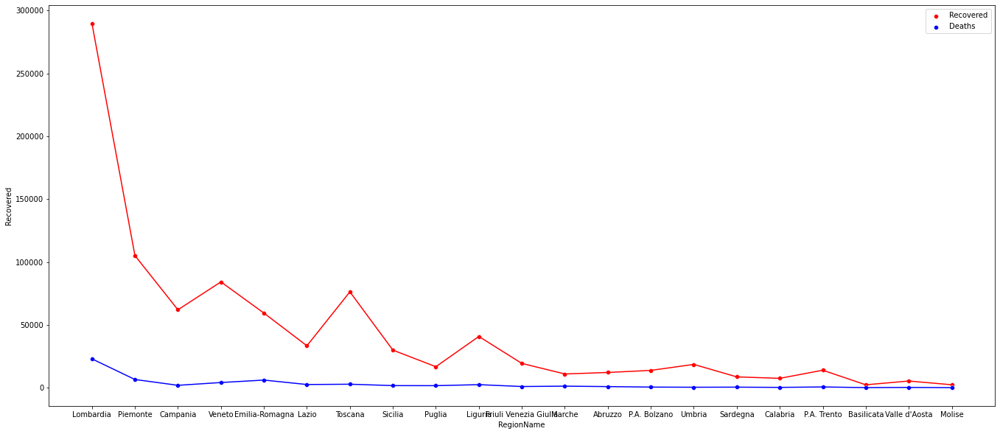

In [41]:
plt.figure(figsize=(23,10))
plt.bar(dgrs_el.RegionName, dgrs_el.Deaths,label="Death")
plt.bar(dgrs_el.RegionName, dgrs_el.Recovered,label="Recovery")
plt.xlabel('Region')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Death and Recovery vs Region', fontsize= 35)
plt.show()

f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="RegionName", y="Recovered", data=dgrs_el,
             color="red",label = "Recovered")
ax=sns.scatterplot(x="RegionName", y="Deaths", data=dgrs_el,
             color="blue",label = "Deaths")
plt.plot(dgrs_el.RegionName,dgrs_el.Recovered,zorder=1,color="red")
plt.plot(dgrs_el.RegionName,dgrs_el.Deaths,zorder=1,color="blue")

In [42]:
data['Date'] = pd.to_datetime(data['Date']).dt.normalize()
latest = data[data.Date == daily.Date.max()]

In [43]:
temp = latest.loc[:,['Date','HospitalizedPatients','IntensiveCarePatients','TotalHospitalizedPatients','HomeConfinement','Recovered','Deaths','TotalPositiveCases','TestsPerformed']]
temp.head()

,Date,HospitalizedPatients,IntensiveCarePatients,TotalHospitalizedPatients,HomeConfinement,Recovered,Deaths,TotalPositiveCases,TestsPerformed
4851,2020-12-06,667,71,738,16350,12206,980,30274,246492
4852,2020-12-06,119,18,137,6231,2397,175,8940,160485
4853,2020-12-06,390,32,422,10239,7533,343,18537,370059
4854,2020-12-06,1916,155,2071,99172,62060,1990,165293,1153658
4855,2020-12-06,2736,241,2977,65190,59432,6162,133761,1115823


<b> Description of Data Grouped by date</b>

In [44]:
temp.describe().T

,count,mean,std,min,25%,50%,75%,max
HospitalizedPatients,21.0,1447.190476,1598.312035,56.0,410.0,667.0,1916.0,6372.0
IntensiveCarePatients,21.0,164.476190,185.866516,8.0,48.0,82.0,241.0,807.0
TotalHospitalizedPatients,21.0,1611.666667,1778.475958,66.0,442.0,738.0,2071.0,7179.0
HomeConfinement,21.0,34355.285714,34858.468792,877.0,9456.0,16350.0,61440.0,109200.0
Recovered,21.0,43499.714286,63667.419390,2397.0,11008.0,18619.0,59432.0,289706.0
Deaths,21.0,2860.857143,4972.920071,135.0,531.0,1327.0,2622.0,23024.0
TotalPositiveCases,21.0,82327.523810,98148.383247,5286.0,24186.0,35467.0,130255.0,429109.0
TestsPerformed,21.0,643340.666667,628595.765702,34644.0,231538.0,333552.0,1000611.0,2415099.0


In [45]:
data_groupby_date = latest.groupby("Date")[['Date','HospitalizedPatients','IntensiveCarePatients','TotalHospitalizedPatients','HomeConfinement','Recovered','Deaths','TotalPositiveCases','TestsPerformed']].sum().reset_index()
data_groupby_date

,Date,HospitalizedPatients,IntensiveCarePatients,TotalHospitalizedPatients,HomeConfinement,Recovered,Deaths,TotalPositiveCases,TestsPerformed
0,2020-12-06,30391,3454,33845,721461,913494,60078,1728878,13510154


<b>Ratio and percentage of Confirmation, Deaths and Deaths, Recovery after Confirmation</b>

In [46]:
ps_ts = float(data_groupby_date.TotalPositiveCases/data_groupby_date.TestsPerformed)
d_ts = float(data_groupby_date.Deaths/data_groupby_date.TestsPerformed)
r_ps = float(data_groupby_date.Recovered/data_groupby_date.TotalPositiveCases)
d_ps = float(data_groupby_date.Deaths/data_groupby_date.TotalPositiveCases)

In [47]:
print("The percentage of Confirmation is "+ str(ps_ts*100) )
print("The percentage of Death is "+ str(d_ts*100) )
print("The percentage of Death after confirmation is "+ str(d_ps*100) )
print("The percentage of recovery after confirmation is "+ str(r_ps*100) )

The percentage of Confirmation is 12.796878555196336
The percentage of Death is 0.4446877511536878
The percentage of Death after confirmation is 3.474970472179066
The percentage of recovery after confirmation is 52.8373893357426


In [48]:
data_groupby_date1 = data.groupby("Date")[['TotalPositiveCases', 'Deaths', 'Recovered','TestsPerformed','HospitalizedPatients','TotalHospitalizedPatients']].sum().reset_index()
dgd3 = data_groupby_date1
dgd3.head()

,Date,TotalPositiveCases,Deaths,Recovered,TestsPerformed,HospitalizedPatients,TotalHospitalizedPatients
0,2020-04-19,178972,23660,47055,935310,25033,27668
1,2020-04-20,181228,24114,48877,943151,24906,27479
2,2020-04-21,183957,24648,51600,971246,24134,26605
3,2020-04-22,187327,25085,54543,1015494,23805,26189
4,2020-04-23,189973,25549,57576,1052577,22871,25138


In [49]:
dgd2 = dgd3
dgd2["Date"]= dgd3["Date"].dt.strftime("%d-%m-%y") 
dgd2.head()

,Date,TotalPositiveCases,Deaths,Recovered,TestsPerformed,HospitalizedPatients,TotalHospitalizedPatients
0,19-04-20,178972,23660,47055,935310,25033,27668
1,20-04-20,181228,24114,48877,943151,24906,27479
2,21-04-20,183957,24648,51600,971246,24134,26605
3,22-04-20,187327,25085,54543,1015494,23805,26189
4,23-04-20,189973,25549,57576,1052577,22871,25138


In [52]:
dgd2=dgd2.tail(14)

<b> Confirmed, Recovery and Death </b>

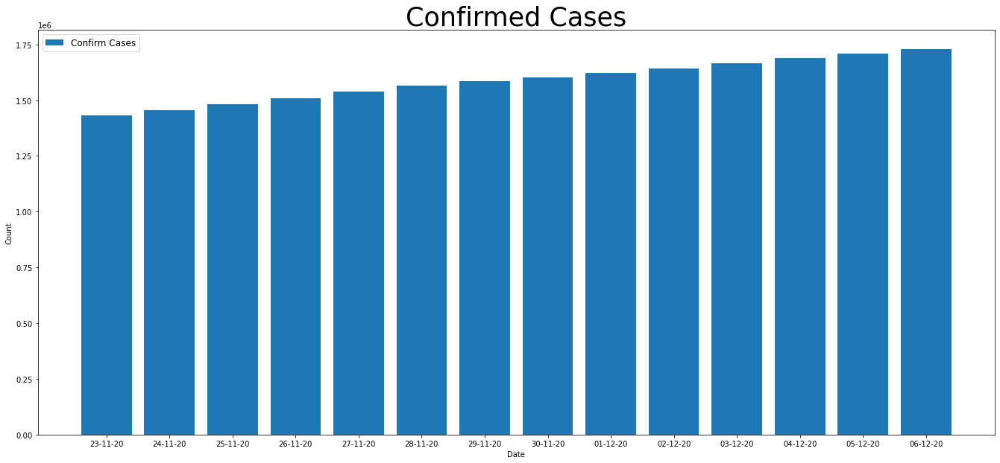

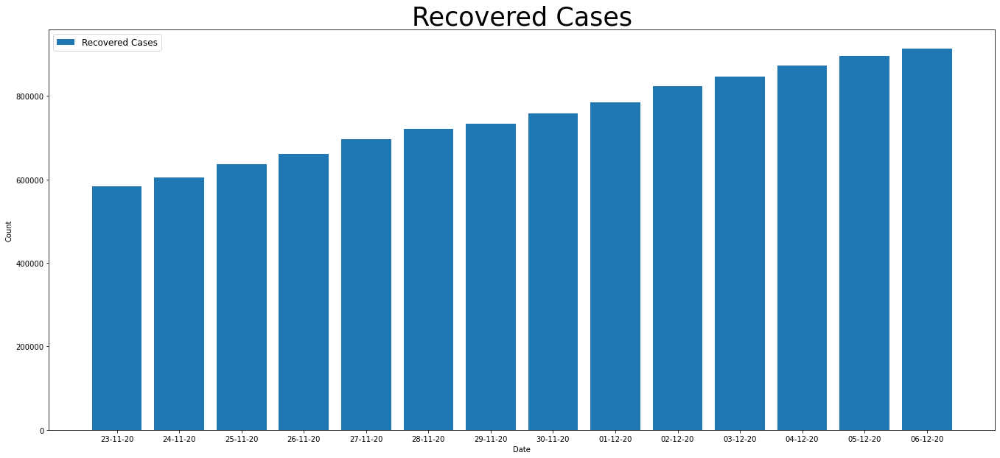

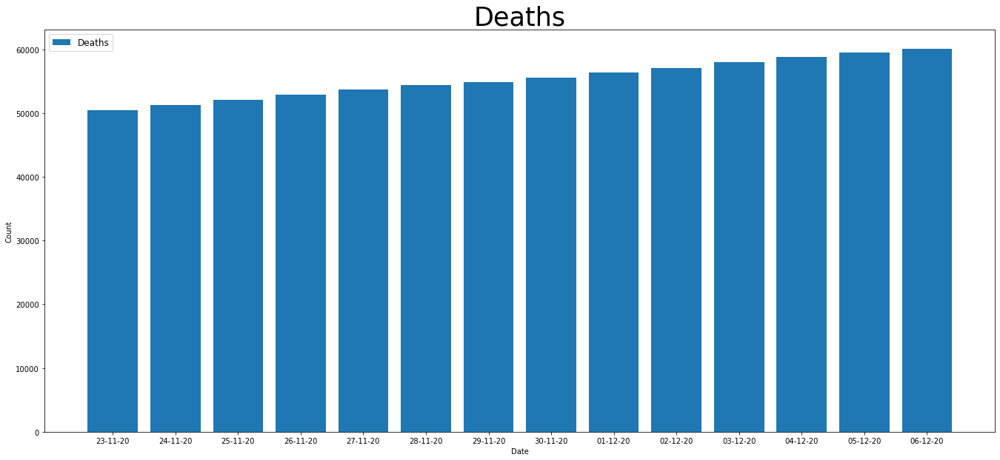

In [53]:
plt.figure(figsize=(23,10))
plt.bar(dgd2["Date"], dgd2["TotalPositiveCases"],label="Confirm Cases")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confirmed Cases',fontsize = 35)
plt.show()

plt.figure(figsize=(23,10))
plt.bar(dgd2.Date, dgd2.Recovered,label="Recovered Cases")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Recovered Cases',fontsize = 35)
plt.show()

plt.figure(figsize=(23,10))
plt.bar(dgd2.Date, dgd2.Deaths,label="Deaths")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Deaths',fontsize = 35)
plt.show()

<b>Test vs Confirmed </b>

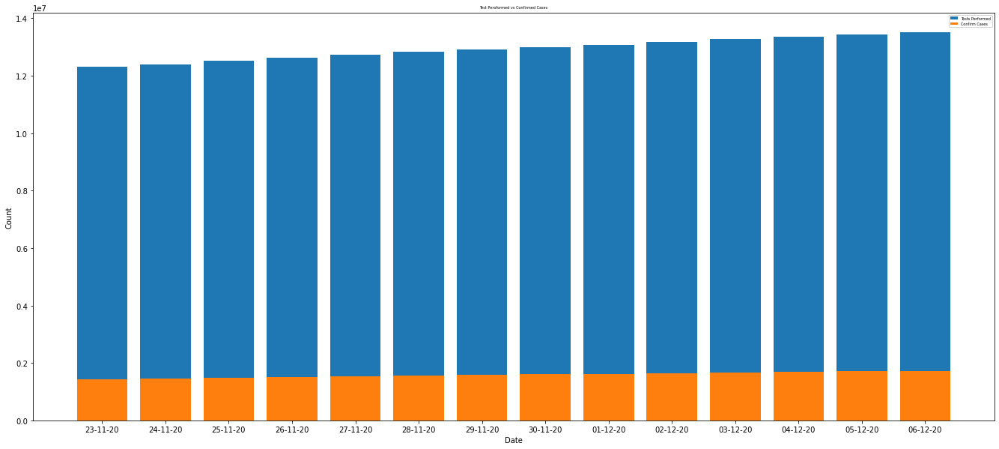

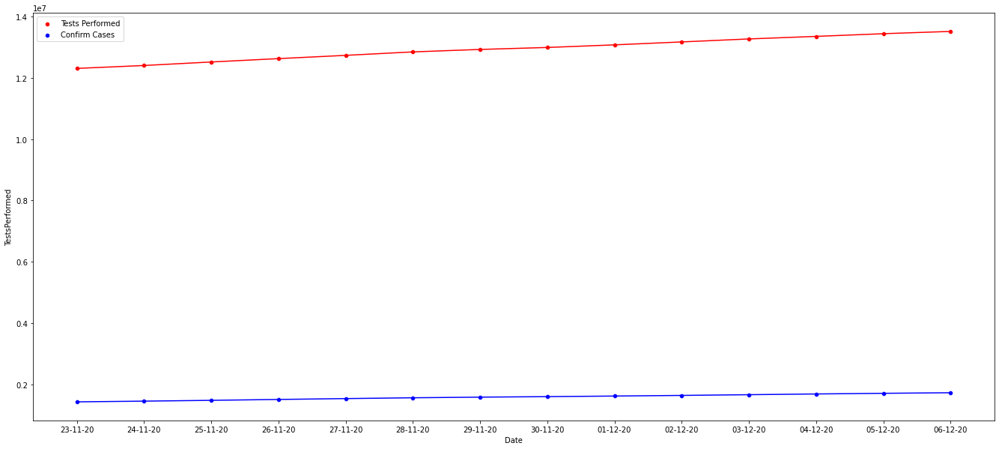

In [54]:
plt.figure(figsize=(23,10))
plt.bar(dgd2.Date, dgd2.TestsPerformed,label="Tests Performed")
plt.bar(dgd2.Date, dgd2.TotalPositiveCases,label="Confirm Cases")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=5)
plt.title('Test Peroformed vs Confirmed Cases',fontsize = 5)
plt.show()

f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="Date", y="TestsPerformed", data=dgd2,
             color="red",label = "Tests Performed")
ax=sns.scatterplot(x="Date", y="TotalPositiveCases", data=dgd2,
             color="blue",label = "Confirm Cases")
plt.plot(dgd2.Date,dgd2.TestsPerformed,zorder=1,color="red")
plt.plot(dgd2.Date,dgd2.TotalPositiveCases,zorder=1,color="blue")

<b>Confirmed cases vs People Hospitalizeed<b>

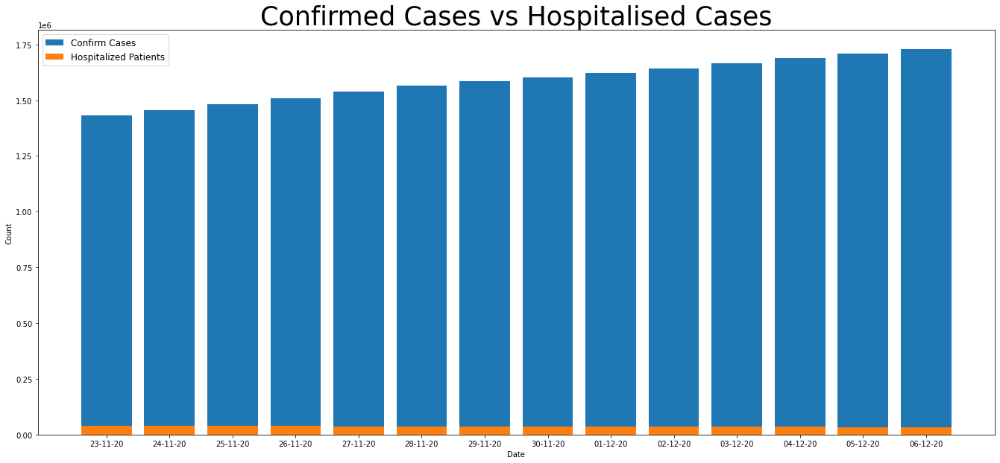

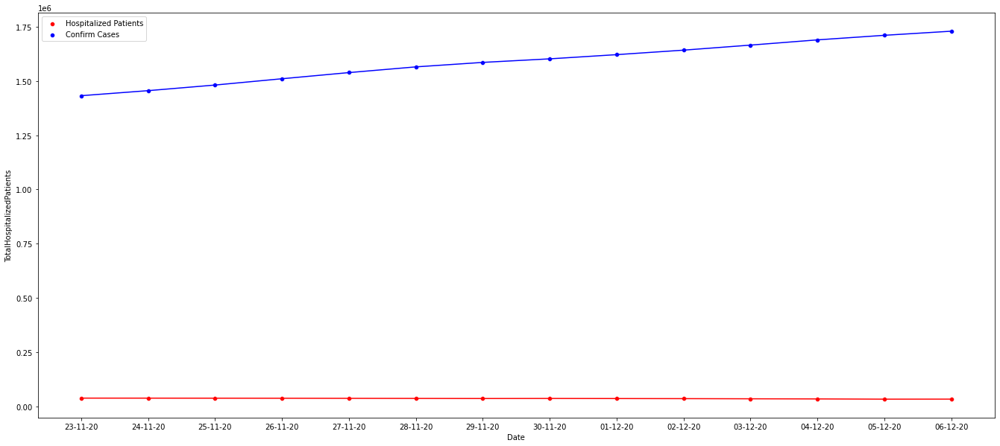

In [55]:

plt.figure(figsize=(23,10))
plt.bar(dgd2.Date, dgd2.TotalPositiveCases,label="Confirm Cases")

plt.bar(dgd2.Date, dgd2.TotalHospitalizedPatients,label="Hospitalized Patients")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confirmed Cases vs Hospitalised Cases',fontsize= 35)
plt.show()

f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="Date", y="TotalHospitalizedPatients", data=dgd2,
             color="red",label = "Hospitalized Patients")
ax=sns.scatterplot(x="Date", y="TotalPositiveCases", data=dgd2,
             color="blue",label = "Confirm Cases")
plt.plot(dgd2.Date,dgd2.TotalHospitalizedPatients,zorder=1,color="red")
plt.plot(dgd2.Date,dgd2.TotalPositiveCases,zorder=1,color="blue")

<b> Hospitalized vs Recovery and Death </b>

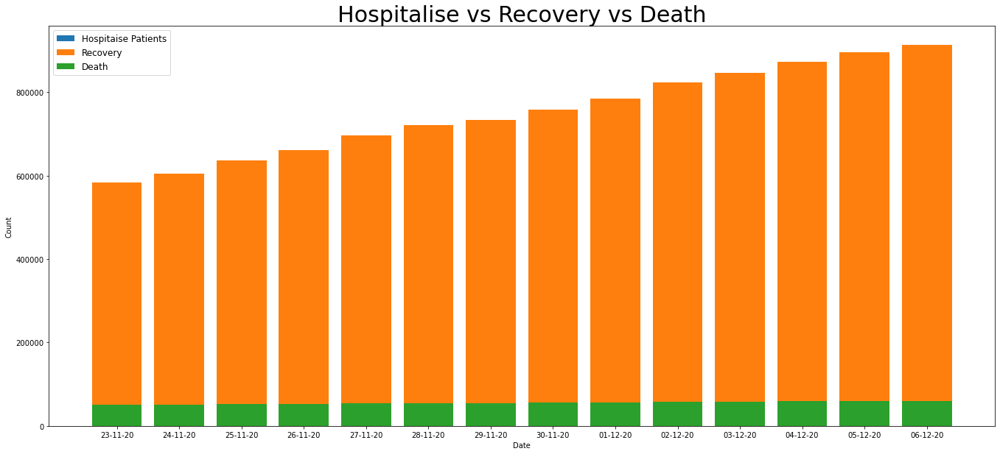

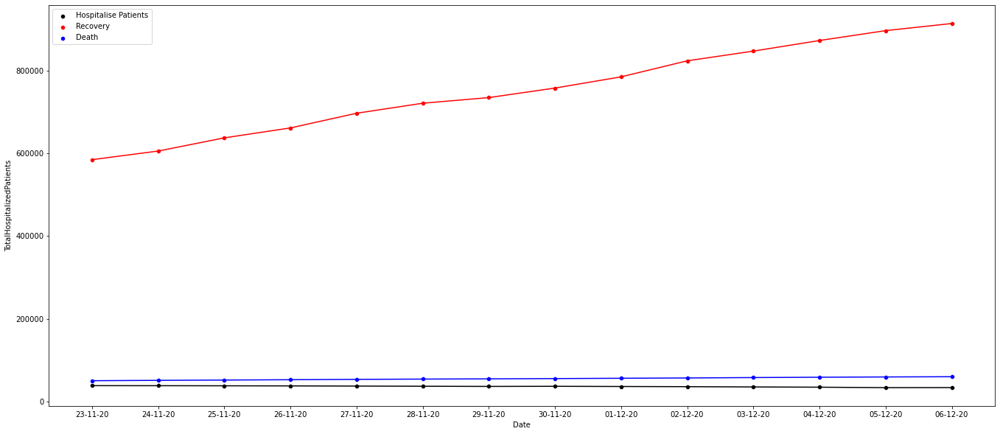

In [56]:
plt.figure(figsize=(23,10))
plt.bar(dgd2.Date, dgd2.TotalHospitalizedPatients,label="Hospitaise Patients")
plt.bar(dgd2.Date, dgd2.Recovered,label="Recovery")
plt.bar(dgd2.Date, dgd2.Deaths,label="Death")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Hospitalise vs Recovery vs Death',fontsize=30)
plt.show()

f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="Date", y="TotalHospitalizedPatients", data=dgd2,
             color="black",label = "Hospitalise Patients")
ax=sns.scatterplot(x="Date", y="Recovered", data=dgd2,
             color="red",label = "Recovery")
ax=sns.scatterplot(x="Date", y="Deaths", data=dgd2,
             color="blue",label = "Death")
plt.plot(dgd2.Date,dgd2.TotalHospitalizedPatients,zorder=1,color="black")
plt.plot(dgd2.Date,dgd2.Recovered,zorder=1,color="red")
plt.plot(dgd2.Date,dgd2.Deaths,zorder=1,color="blue")


In [57]:
data_groupby_date1 = data.groupby("Date")[['TotalPositiveCases', 'Deaths', 'Recovered','TestsPerformed','HospitalizedPatients','TotalHospitalizedPatients']].sum().reset_index()
dgd1 = data_groupby_date1

In [58]:
dgd1['Confirmed_new'] = dgd1['TotalPositiveCases']-dgd1['TotalPositiveCases'].shift(1)
dgd1['Recovered_new'] = dgd1['Recovered']-dgd1['Recovered'].shift(1)
dgd1['Deaths_new'] = dgd1['Deaths']-dgd1['Deaths'].shift(1)
dgd1['TotalHospitalizedPatients_new'] = dgd1['TotalHospitalizedPatients']-dgd1['TotalHospitalizedPatients'].shift(1)

In [59]:
dgd1.head()

,Date,TotalPositiveCases,Deaths,Recovered,TestsPerformed,HospitalizedPatients,TotalHospitalizedPatients,Confirmed_new,Recovered_new,Deaths_new,TotalHospitalizedPatients_new
0,2020-04-19,178972,23660,47055,935310,25033,27668,NaN,NaN,NaN,NaN
1,2020-04-20,181228,24114,48877,943151,24906,27479,2256.0,1822.0,454.0,-189.0
2,2020-04-21,183957,24648,51600,971246,24134,26605,2729.0,2723.0,534.0,-874.0
3,2020-04-22,187327,25085,54543,1015494,23805,26189,3370.0,2943.0,437.0,-416.0
4,2020-04-23,189973,25549,57576,1052577,22871,25138,2646.0,3033.0,464.0,-1051.0


<b>Confirm, Hospitalized, Recovered and Deaths </b>

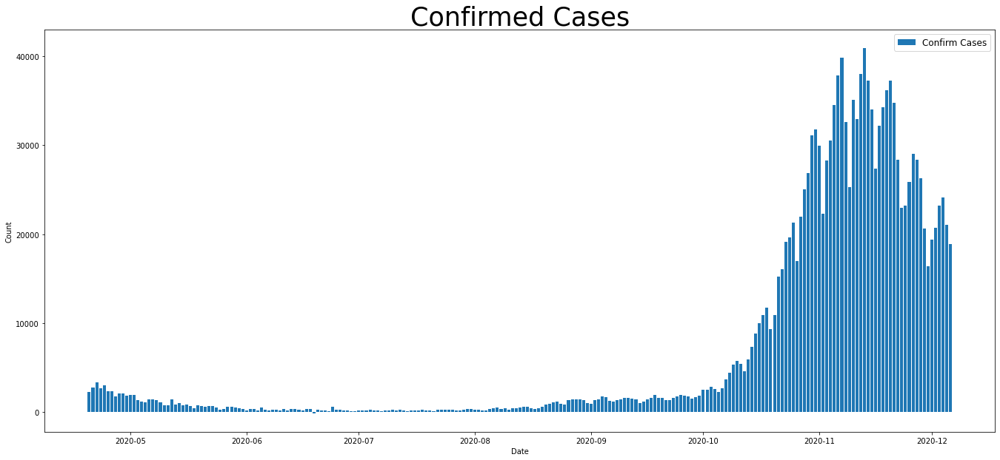

In [60]:
plt.figure(figsize=(23,10))
plt.bar(dgd1.Date, dgd1.Confirmed_new,label="Confirm Cases")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Confirmed Cases',fontsize = 35)
plt.show()

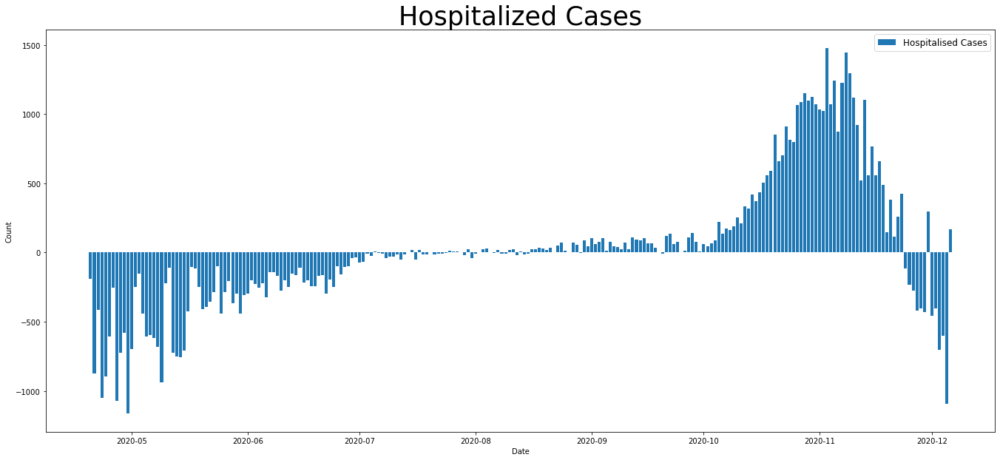

In [61]:
plt.figure(figsize=(23,10))
plt.bar(dgd1.Date, dgd1.TotalHospitalizedPatients_new,label="Hospitalised Cases")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Hospitalized Cases',fontsize = 35)
plt.show()

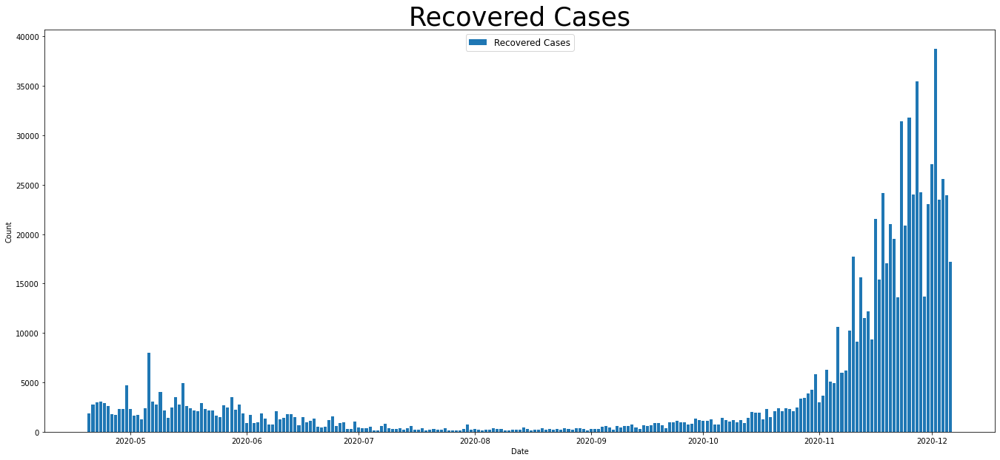

In [62]:
plt.figure(figsize=(23,10))
plt.bar(dgd1.Date, dgd1.Recovered_new,label="Recovered Cases")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Recovered Cases',fontsize = 35)
plt.show()

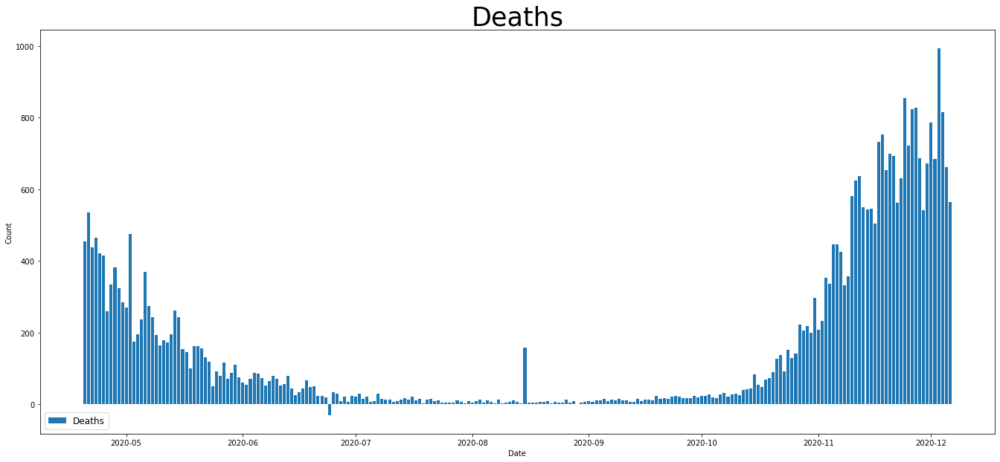

In [63]:
plt.figure(figsize=(23,10))
plt.bar(dgd1.Date, dgd1.Deaths_new,label="Deaths")
plt.xlabel('Date')
plt.ylabel("Count")
plt.legend(frameon=True, fontsize=12)
plt.title('Deaths',fontsize = 35)
plt.show()

In [64]:
dgd1['gr_date'] =dgd1["Date"].dt.strftime("%d-%m-%y") 

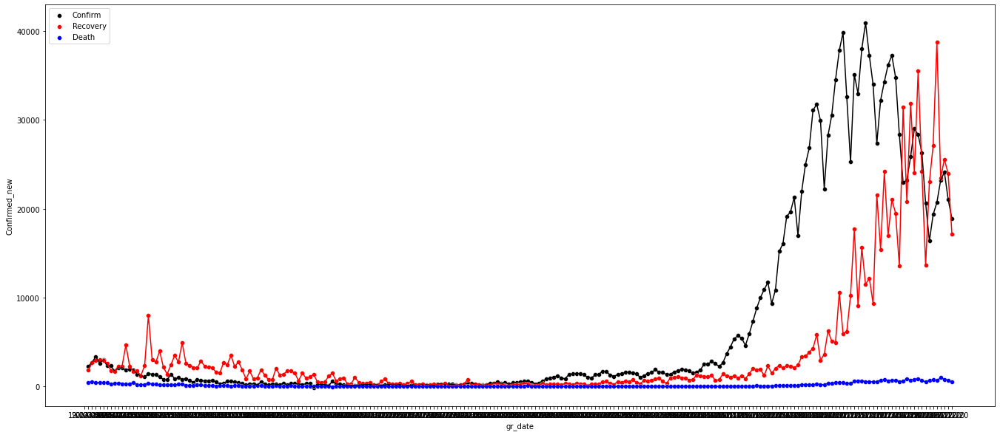

In [65]:
idata = dgd1
f, ax = plt.subplots(figsize=(23,10))
ax=sns.scatterplot(x="gr_date", y="Confirmed_new", data=idata,
             color="black",label = "Confirm")
ax=sns.scatterplot(x="gr_date", y="Recovered_new", data=idata,
             color="red",label = "Recovery")
ax=sns.scatterplot(x="gr_date", y="Deaths_new", data=idata,
             color="blue",label = "Death")
plt.plot(idata.gr_date,idata.Confirmed_new,zorder=1,color="black")
plt.plot(idata.gr_date,idata.Recovered_new,zorder=1,color="red")
plt.plot(idata.gr_date,idata.Deaths_new,zorder=1,color="blue")